# LSTM ResOps-ES: results
***

***Author:** Chus Casado Rodríguez*<br>
***Date:** 04-06-2024*<br>

**Introduction:**<br>

**To do**:
* [ ] Use the `run_dir` to define the run(s) to be analysed instead of the `CONFIG_FILE`. The orginal configuration file might be lost, changed, etc, but the data inside `run_dir` (which includes a copy of the configuration file with generic name _config.yml_) should not. This is actually how the evaluation is done in `NeuralHydrology`.

In [1]:
import os
import sys
sys.path.append('../')
# import pickle
import numpy as np
import pandas as pd
import xarray as xr
from pathlib import Path
import torch
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
import seaborn as sns
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from neuralhydrology.utils.config import Config
from neuralhydrology.evaluation import metrics
from neuralhydrology.nh_run import start_run, eval_run

from model_utils import get_results, plot_timeseries #*
from plots import create_cmap
from metrics import ECDF

In [2]:
import warnings

with warnings.catch_warnings():
    warnings.simplefilter("ignore")

## Configuration

In [3]:
USE = None
SINGLE_USE = False
TARGET = 'volume'
CONFIG_FILE = 'config_V_bc_adamw_lrL.yml' # 'config_V_time_validation.yml' #'config_V_lstm256_fc00_do04.yml' # None
EVAL_PERIODS = ['train', 'validation', 'test']
METRIC = 'KGE'

## Read results

In [4]:
# cargar archivo de configuración
if USE:
    exp_dir = Path(f'./{USE}/{TARGET}/')
else:
    exp_dir = Path(f'./all/{TARGET}/')

# identify config files in the experiment folder
if CONFIG_FILE is None:
    config_files = list(exp_dir.glob('config*.yml'))
else:
    config_files = [exp_dir / CONFIG_FILE]
n_experiments = len(config_files)

performance = {period: {} for period in EVAL_PERIODS}
run_dirs = {}
for config_file in tqdm(config_files, desc='experiments'):

    # read config file
    cfg = Config(config_file)
    print('Experiment:', cfg.experiment_name, sep='\t')

    # find the directory of the last run
    root_run_dir = cfg.run_dir if cfg.run_dir else Path(config_file.parent / 'runs')
    run_dir = max([x for x in root_run_dir.iterdir() if x.is_dir() & ('_'.join(x.stem.split('_')[:-2]) == cfg.experiment_name)])
    run_dirs[cfg.experiment_name] = run_dir
    print('\tRun directory:', run_dir, sep='\t')
    
    # extract performance for each period and epoch
    for period in performance.keys():
        dct = {}
        for epoch in range(1, cfg.epochs + 1):
            try:
                _, perf = get_results(run_dir, period, epoch=epoch)
                perf.index.name = 'basin'
                perf.sort_index(axis=0, inplace=True)
                dct[epoch] = xr.Dataset.from_dataframe(perf).expand_dims({'epoch': [epoch]})#.to_array(dim='metric')
            except Exception as e:
                print(f'\t{e}')
                continue
                
        # convert to xarray
        try:
            ds = xr.concat(dct.values(), dim='epoch')#.assign_coords(epoch=list(dct))
            ds = ds.expand_dims({'experiment': [cfg.experiment_name]})

            # save results
            performance[period][cfg.experiment_name] = ds #da
        except Exception as e:
            print(f'\t{e}')
            continue
    print()
performance = {period: xr.concat(dct.values(), dim='experiment') for period, dct in performance.items()}

experiments:   0%|          | 0/1 [00:00<?, ?it/s]

Experiment:	V_bc_adamw_lrL
	Run directory:	all/volume/runs/V_bc_adamw_lrL_1106_170621



In [5]:
for period, ds, in performance.items():
    print('{0:>10}:\t{1} reservoirs'.format(period, len(ds.basin)))

     train:	97 reservoirs
validation:	32 reservoirs
      test:	32 reservoirs


## Analyse results

### Performance

#### Compare experiments

In [6]:
if (len(config_files) > 1):
    colors = [f'C{i}' for i in range(0, n_experiments)]

    fig, ax = plt.subplots(figsize=(8, 4))
    for (period, ds), ls in zip(performance.items(), [':', '-']):
        ds[METRIC].median('basin').to_pandas().transpose().plot(ax=ax, ls=ls, color=colors)
    ax.set(xlim=(1, ds.epoch.max()),
           # ylim=(-.02, 1.02),
           ylabel=METRIC)

    # Create custom legend handles for 'train' and 'validation'
    train_handle = mlines.Line2D([], [], color='gray', linestyle=':')
    validation_handle = mlines.Line2D([], [], color='gray', linestyle='-')
    blank_handle = mlines.Line2D([], [], color='white', linestyle='-')

    # remove default legend
    ax.legend().set_visible(False)

    # legend
    handles, labels = ax.get_legend_handles_labels()
    handles, labels = handles[-n_experiments:], labels[-n_experiments:]
    handles = [train_handle, validation_handle, blank_handle] + handles
    labels = ['train', 'validation', ''] + labels
    fig.legend(handles, labels, frameon=False, bbox_to_anchor=[1.05, .2, .2, .6]);

#### Evolution over epochs

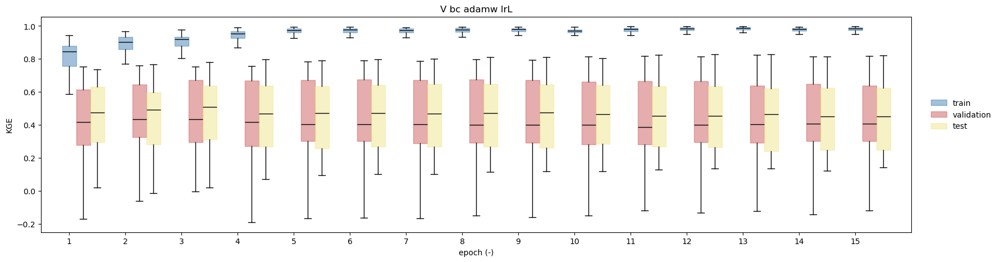

In [7]:
for experiment, run_dir in run_dirs.items():

    fig, ax = plt.subplots(figsize=(20, 5))

    colors = ['steelblue', 'indianred', 'khaki']
    patches = []
    for i, ((period, ds), c) in enumerate(zip(performance.items(), colors)):
        df = ds.sel(experiment=experiment)[METRIC].to_pandas().transpose().copy()
        df.dropna(axis=0, how='any', inplace=True)
        bp = ax.boxplot(df, positions=df.columns + i * .25, widths=0.25,
                        patch_artist=True,
                        boxprops={'color': c, 'alpha': .5},
                        # whiskerprops={},
                        showfliers=False,
                        medianprops={'color': 'k'})
        for box in bp['boxes']:
            box.set_facecolor(c)
        patches.append(mpatches.Patch(color=c, alpha=.5, label=period))

    # settings
    xticks = np.linspace(1, cfg.epochs, num=cfg.epochs).astype(int)
    ax.set_xticks(xticks)
    ax.set_xticklabels(xticks)
    title = ' '.join(experiment.split('_'))
    ax.set(xlabel='epoch (-)',
           ylabel=METRIC,
           #ylim=(None, 1.02),
           title=title);
    ax.legend(handles=patches, frameon=False, bbox_to_anchor=[1, .35, .1, .3]);
    
    # save
    path = run_dir / 'plots'
    path.mkdir(parents=True, exist_ok=True)
    plt.savefig(run_dir / f'evolution_{METRIC}.jpg', dpi=300, bbox_inches='tight')

In [8]:
# find best validation epoch for each experiment
best_epoch = performance['validation'][METRIC].median('basin').idxmax('epoch')
best_epoch = best_epoch.astype(int).data[0]
#best_epoch = -1 # 15
print('best epoch:', best_epoch)

summary = pd.DataFrame(index=list(run_dirs), columns=EVAL_PERIODS)
for exp in summary.index:
    for sample in summary.columns:
        summary.loc[exp, sample] = performance[sample][METRIC].sel(experiment=exp).sel(epoch=best_epoch).median('basin').data
summary = summary.round(3)
summary.sort_index(axis=0)

best epoch: 3


,train,validation,test
V_bc_adamw_lrL,0.9189707360936208,0.434241400039663,0.50985388707692


#### Geographical distribution

In [9]:
# load attribute table
reservoirs = pd.read_csv(cfg.data_dir / 'attributes' / 'attributes_combined.csv', index_col='reservoir_id')
reservoirs = reservoirs[reservoirs.columns.intersection(cfg.static_attributes + ['RES_NAME'])]
reservoirs.dropna(axis=0, how='any', inplace=True)
reservoirs.sort_index(axis=0, inplace=True)
print('Reservoirs in the original attribute table:\t\t{0}\n'.format(reservoirs.shape[0]))

Reservoirs in the original attribute table:		260



In [10]:
# load reservoir use table
use = pd.read_csv(cfg.data_dir / 'attributes' / 'attributes_use.csv', index_col='reservoir_id')
use = use[use.columns.intersection(cfg.static_attributes)]
use.dropna(axis=0, how='any', inplace=True)
print('Reservoirs in the original use table:\t\t\t{0}\n'.format(use.shape[0]))

reservoirs = pd.concat((reservoirs, use), axis=1, join='inner')

Reservoirs in the original use table:			290



In [11]:
reservoirs['sample'] = None
perf_df = pd.DataFrame(dtype=float)
for sample, ds in performance.items():
    # define sample
    IDs = ds.basin.data
    reservoirs.loc[IDs, 'sample'] = sample
    # extract performance metrics
    df = ds.isel(epoch=-1).sel(experiment=exp).to_pandas()
    df.drop(['experiment', 'epoch'], axis=1, inplace=True)
    perf_df = pd.concat((perf_df, df), axis=0)

In [12]:
reservoirs = pd.concat((reservoirs, perf_df), axis=1, join='inner')

reservoirs = reservoirs.loc[~reservoirs['sample'].isna(),:]
reservoirs.shape

(161, 22)

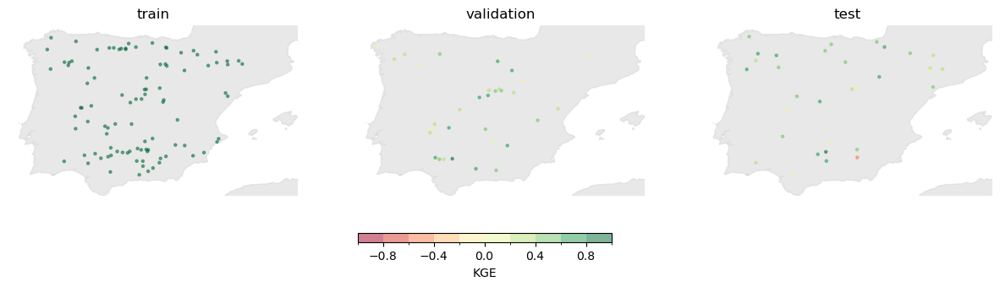

In [13]:
cmap, norm = create_cmap('RdYlGn', bounds=[-1, -.8, -.6, -.4, -.2, 0, .2, .4, .6, .8, 1])

# plot reservoir locations
fig, axes = plt.subplots(ncols=3, figsize=(15, 3.5), subplot_kw=dict(projection=ccrs.PlateCarree()))

for ax, sample in zip(axes, EVAL_PERIODS):
    ax.add_feature(cfeature.NaturalEarthFeature('physical', 'land', '10m', edgecolor='face', facecolor='lightgray'),
                   alpha=.5,
                   zorder=0)
    mask = reservoirs['sample'] == sample
    sct = ax.scatter(reservoirs.loc[mask, 'LON'],
                     reservoirs.loc[mask, 'LAT'],
                     c=reservoirs.loc[mask, METRIC],
                     cmap=cmap, norm=norm, s=5, alpha=.5)
    ax.set(aspect='equal',
           extent=[-10, 3.5, 36, 44],
           title=sample)
    ax.axis('off');

cbar_ax = fig.add_axes([0.4, 0.05, 0.2, 0.03])  # [left, bottom, width, height]
cb = fig.colorbar(sct, cax=cbar_ax, orientation='horizontal')
cb.set_label(METRIC)

# plt.savefig(path / f'map_{METRIC}.jpg', dpi=300, bbox_inches='tight');

#### Relationship between metrics

/storage/casadje/conda/neuralhydrology/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/storage/casadje/conda/neuralhydrology/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/storage/casadje/conda/neuralhydrology/lib/python3.10/site-packages/seaborn/_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/storage/casadje/conda/neuralhydr

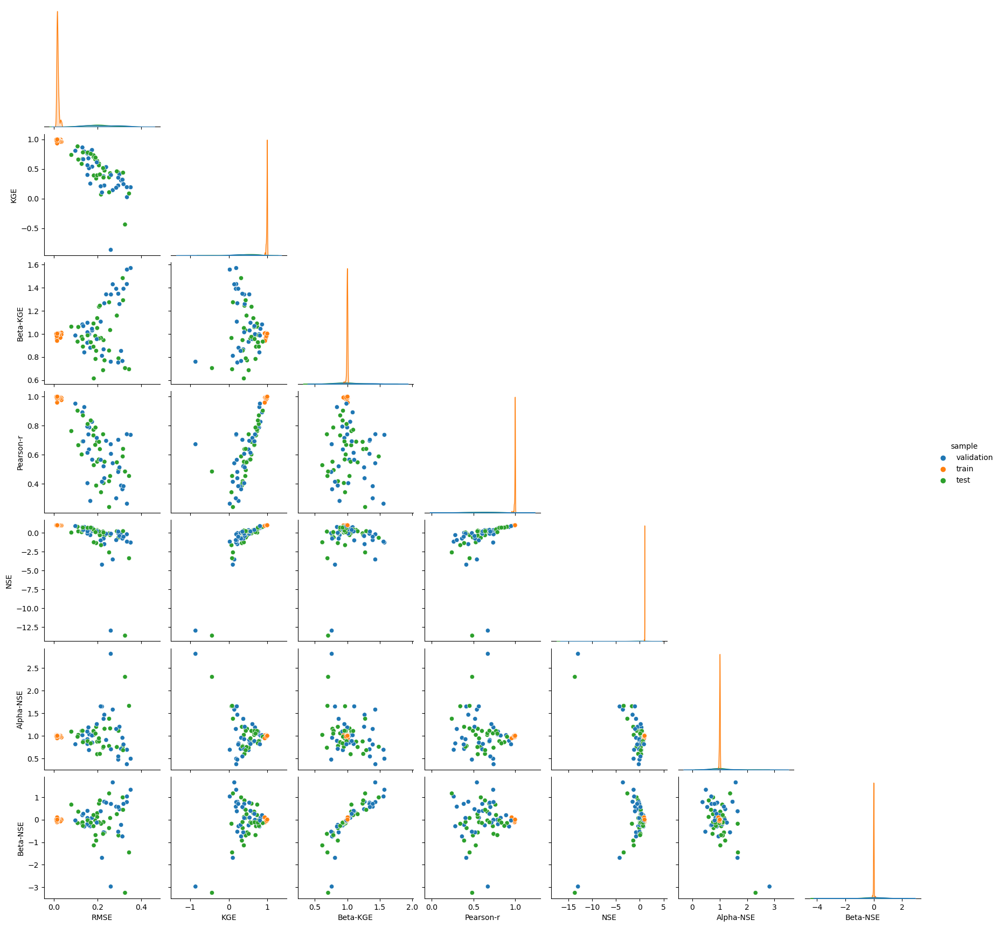

In [15]:
reservoirs.replace([np.inf, -np.inf], np.nan, inplace=True)

sns.pairplot(reservoirs, vars=cfg.metrics, hue='sample', corner=True);

#### Performance vs characteristics

In [ ]:
variables = ['CAP_MCM', 'AREA_SKM', 'DAM_HGT_M', 'ELEV_MASL', 'CATCH_SKM', 'DOD_M', 'DOR']

fig, axes = plt.subplots(ncols=len(variables), figsize=(4 * len(variables), 3.7), sharey=True)

for ax, var in zip(axes, variables):
    for i, sample in enumerate(EVAL_PERIODS):
        mask = reservoirs['sample'] == sample
        ax.scatter(reservoirs.loc[mask, var], reservoirs.loc[mask, METRIC], c=f'C{i}', alpha=.6, label=sample)
    if ax == axes[0]:
        ax.set(ylabel=METRIC,
               # ylim=(None, 1.05)
              )
    ax.set(xlabel=var)
    
fig.legend(*ax.get_legend_handles_labels(), ncol=3, loc=8, frameon=False, bbox_to_anchor=[.33, -0.1, .33, .05]);

In [ ]:
variables = ['flood', 'hydropower', 'irrigation', 'supply']

fig, axes = plt.subplots(ncols=len(variables), figsize=(4 * len(variables), 3.7), sharey=True)

for ax, var in zip(axes, variables):
    for i, sample in enumerate(EVAL_PERIODS):
        # mask = reservoirs['sample'] == sample
        # ax.scatter(reservoirs.loc[mask, var], reservoirs.loc[mask, METRIC], c=f'C{i}', alpha=.6, label=sample)
        mask_use = reservoirs[var] == 1
        mask_sample = reservoirs['sample'] == sample
        # sns.displot(reservoirs.loc[mask_use & mask_sample, METRIC], kind='kde', ax=ax)
        ax.hist(reservoirs.loc[mask_use & mask_sample, METRIC], density=True)
    if ax == axes[0]:
        ax.set(xlabel=METRIC,
               # ylim=(None, 1.05)
              )
    ax.set(xlabel=var)
    
fig.legend(*ax.get_legend_handles_labels(), ncol=3, loc=8, frameon=False, bbox_to_anchor=[.33, -0.1, .33, .05]);

In [ ]:
from scipy.stats import gaussian_kde

In [ ]:
kde = gaussian_kde(reservoirs.loc[mask_use & mask_sample, METRIC])

In [ ]:
x = np.linspace(reservoirs.loc[mask_use & mask_sample, METRIC].min(), reservoirs.loc[mask_use & mask_sample, METRIC].max())
plt.plot(x, kde(x))

In [ ]:
np.isinf(reservoirs[METRIC]).sum()

In [ ]:
plt.hist(density=True)

#### ECDF

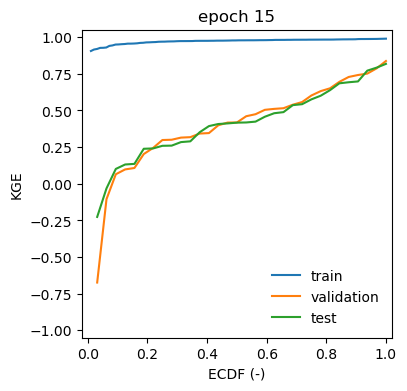

In [17]:
# compute ECDF for each sample
ecdfs = {sample: ECDF(ds.sel(experiment=exp).isel(epoch=-1)[METRIC].to_pandas(), plot=False) for sample, ds in performance.items()}

fig, ax = plt.subplots(figsize=(4, 4))
for sample, ecdf in ecdfs.items():
    ax.plot(ecdf, label=sample)
ax.set(ylabel=METRIC,
       xlabel='ECDF (-)',
       ylim=(-1.05, 1.05),
       xlim=(-.02, 1.02),
       title='epoch {0}'.format(ds.epoch.data[-1]))
ax.legend(frameon=False);

***

### Time series

In [15]:
# import time series (observed and simulated) 
series = {}
for experiment, run_dir in run_dirs.items():
    series[experiment] = {}
    for period in EVAL_PERIODS:
        try:
            ts, _ = get_results(run_dir, period, epoch=best_epoch)#best_epoch.sel(experiment=experiment).data)
            series[experiment][period] = ts
        except:
            continue

/home/casadje/neuralhydrology/models/ResOpsES/../model_utils.py:240: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=figsize)#, sharex=True, sharey=True)


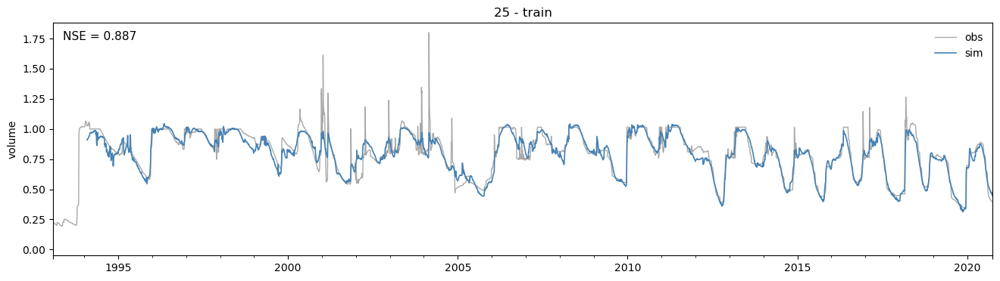

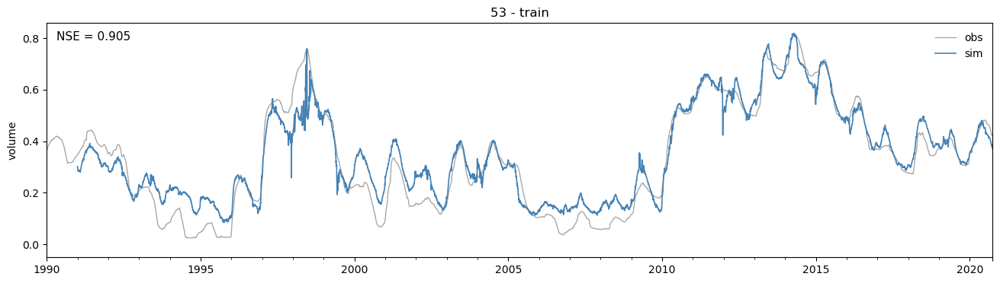

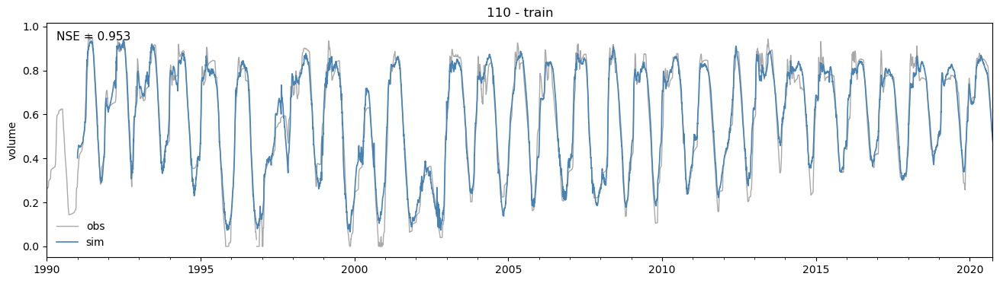

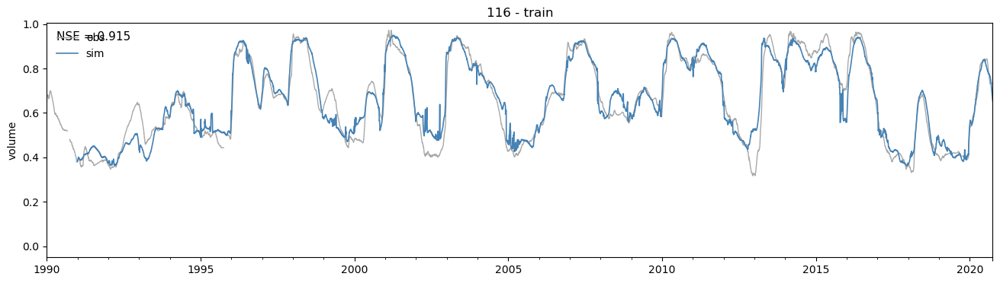

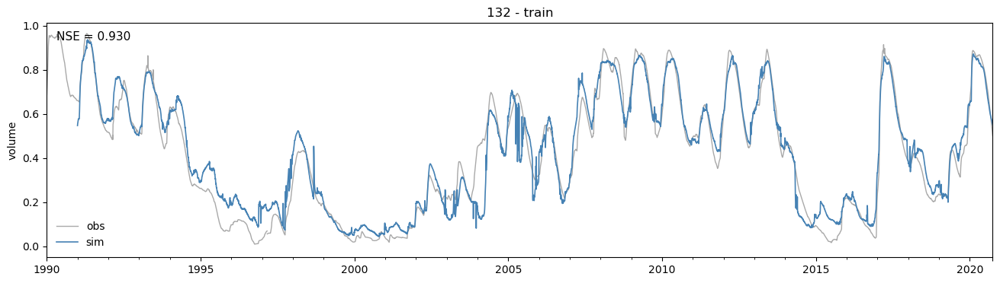

...

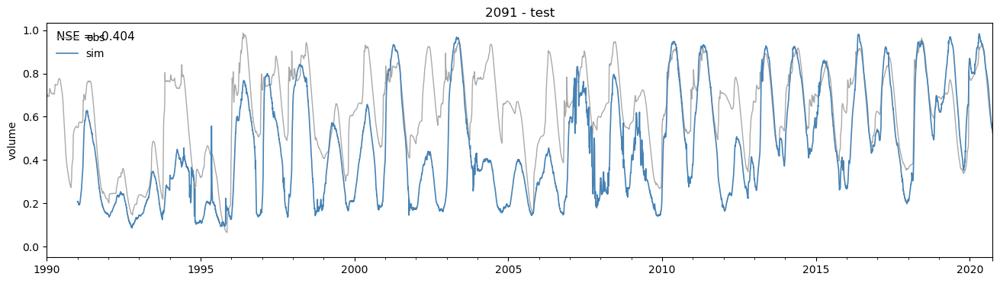

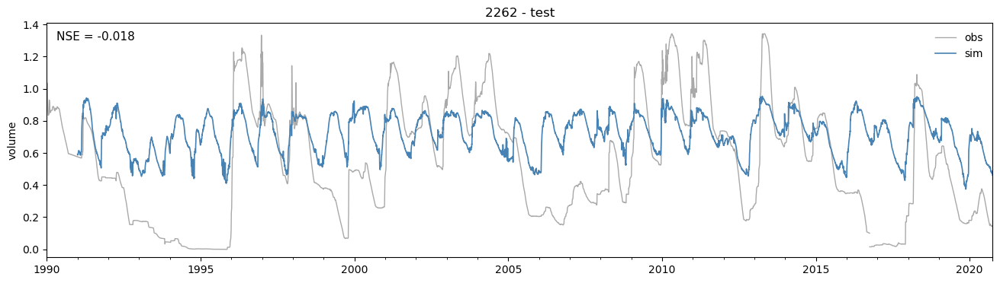

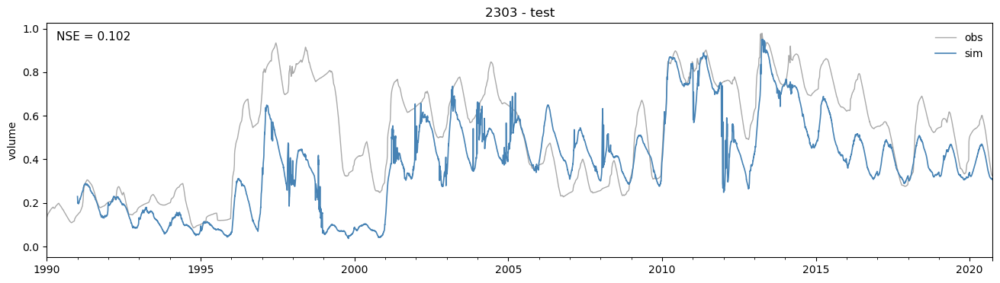

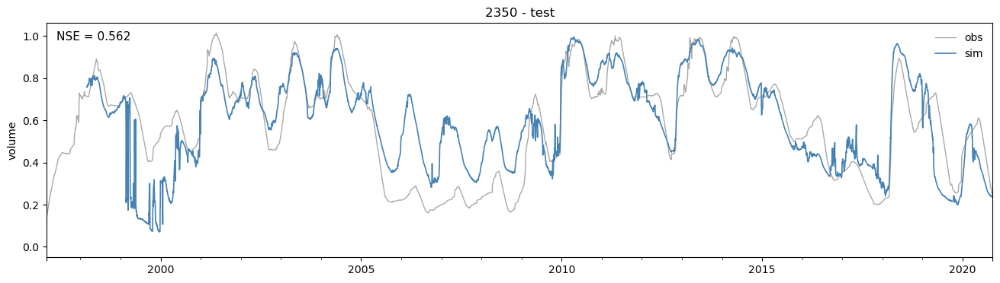

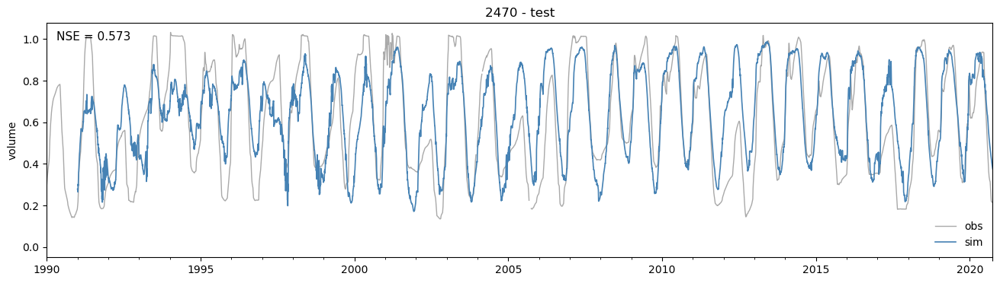

In [16]:
# plot time series
for experiment, run_dir in run_dirs.items():
    plot_timeseries(series[experiment],
                    target=cfg.target_variables[0],
                    save=run_dir)